In [1]:
# imports
import datetime as dt
import matplotlib.pylab as plt
import matplotlib.dates as mdates
import nest_asyncio
import numpy as np
import os
import pandas as pd
import pandas_datareader.data as web
import re
from textblob import TextBlob
import twint

from matplotlib.pyplot import figure
import plotly as py
from plotly.offline import init_notebook_mode, iplot
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

nest_asyncio.apply()

In [2]:
%%time
# Configure
c = twint.Config()
# c.Username = ""
c.Search = "$tsla"
c.Store_csv = True
c.Output = "Output"
c.limit = 100000

# Run
twint.run.Search(c)

1340868484373250048 2020-12-20 22:55:33 -0500 <becomingGuru> @Schuldensuehner Why only see just YTD.  Last 5 months, #btc outperformed $tsla  https://t.co/hgAl5xo1kl
1340868414500270082 2020-12-20 22:55:16 -0500 <estockspro> ***Big Runner $PVDG Alerted*** - $BRTXQ $JADA $HDII $AMRN $NWBO $CYDY $RLFTF $OPTI $PASO $IGEN $ARSN $PCTL $IPIX $VRUS $IJJP $APYP $TSLA $RXMD $AAWC $TPTW $AVXL $FBHC $GAXY $HGEN $SHMN $RBII $UDHI $TSNP $GTEH $ATVK $NPHC
1340868229082824705 2020-12-20 22:54:32 -0500 <Alearmas> @gualestrit $TSLA y $PTON
1340867837238398979 2020-12-20 22:52:59 -0500 <b_will_3> Thanks @elonmusk $TSLA  https://t.co/G5OFjHsPRJ
1340867757043269637 2020-12-20 22:52:40 -0500 <hoodinrobinhood> More stimulus? I’m buying $TSLA $BTC $DASH and @Cokedupoptions ex-wife a seafood dinner
1340867617372991488 2020-12-20 22:52:06 -0500 <gneffa> Y si Elon Musk accede a comprar Bitcoins para $TSLA? Cuántos lo seguirían? Cuantas empresas seguirían? A cuánto estará el $BTC?  https://t.co/FQTasJ2FB0
134086

TimeoutError: 

In [4]:
df = pd.read_csv('PAR/Output/tweets.csv')
print(df.shape)
df.head()

(169819, 36)


/Users/josephbell/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3058: DtypeWarning:

Columns (9) have mixed types. Specify dtype option on import or set low_memory=False.



,id,conversation_id,created_at,date,time,timezone,user_id,username,name,place,...,geo,source,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest
0,1340868484373250048,1340714174003998720,2020-12-20 22:55:33 EST,2020-12-20,22:55:33,-500,17776672,becomingguru,Lakshman Prasad,NaN,...,NaN,NaN,NaN,NaN,NaN,"[{'screen_name': 'Schuldensuehner', 'name': 'H...",NaN,NaN,NaN,NaN
1,1340868414500270082,1340868414500270082,2020-12-20 22:55:16 EST,2020-12-20,22:55:16,-500,1301769669209026560,estockspro,estockspro,NaN,...,NaN,NaN,NaN,NaN,NaN,[],NaN,NaN,NaN,NaN
2,1340868229082824705,1340709579815051266,2020-12-20 22:54:32 EST,2020-12-20,22:54:32,-500,49379237,alearmas,Alejandro Armas,NaN,...,NaN,NaN,NaN,NaN,NaN,"[{'screen_name': 'gualestrit', 'name': 'Guales...",NaN,NaN,NaN,NaN
3,1340867837238398979,1340867837238398979,2020-12-20 22:52:59 EST,2020-12-20,22:52:59,-500,906168718060904448,b_will_3,kampana 🛎,NaN,...,NaN,NaN,NaN,NaN,NaN,[],NaN,NaN,NaN,NaN
4,1340867757043269637,1340867757043269637,2020-12-20 22:52:40 EST,2020-12-20,22:52:40,-500,1340847868920410113,hoodinrobinhood,Tanner T. (not gay),NaN,...,NaN,NaN,NaN,NaN,NaN,[],NaN,NaN,NaN,NaN


In [5]:
df.columns

Index(['id', 'conversation_id', 'created_at', 'date', 'time', 'timezone',
       'user_id', 'username', 'name', 'place', 'tweet', 'language', 'mentions',
       'urls', 'photos', 'replies_count', 'retweets_count', 'likes_count',
       'hashtags', 'cashtags', 'link', 'retweet', 'quote_url', 'video',
       'thumbnail', 'near', 'geo', 'source', 'user_rt_id', 'user_rt',
       'retweet_id', 'reply_to', 'retweet_date', 'translate', 'trans_src',
       'trans_dest'],
      dtype='object')

In [6]:
df['date'].min()

'2020-11-09'

In [36]:
# plan
# look at volume of tweets by day - should increase with news, price movement
# look at sentiment analysis of tweets
# could give a higher weight to tweets with more replies, likes and retweets
# that show signal vs noise of news or bot accounts
# compare to stock prices

In [7]:
# look at volume of tweets by day
tweet_volume_by_date = df.groupby('date').count()

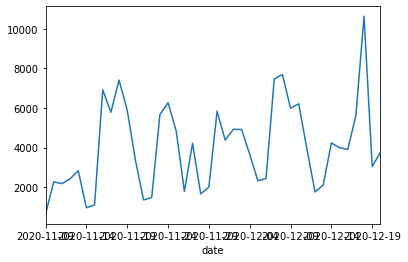

In [8]:
tweet_volume_by_date['id'].plot();

index
2020-11-09     648
2020-11-10    2268
2020-11-11    2177
2020-11-12    2420
2020-11-13    2831
Name: id, dtype: int64


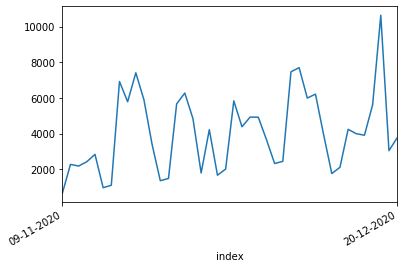

In [9]:
# convert date objects from pandas format to python datetime
index = tweet_volume_by_date.index
index = [pd.to_datetime(date, format='%Y-%m-%d').date() for date in index]
tweet_volume_by_date['index'] = index
tweet_volume_by_date = tweet_volume_by_date.set_index('index')
# data = tweet_volume_by_date['id']
# df_2 = pd.DataFrame(data=data,index=index, columns=['data'])
df_2 = tweet_volume_by_date['id']
print (df_2.head())

ax = df_2.plot()
# set monthly locator
ax.xaxis.set_major_locator(mdates.MonthLocator(interval=24))
# set formatter
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%Y'))
# set font and rotation for date tick labels
plt.gcf().autofmt_xdate()

plt.show()

In [10]:
# sentiment analysis on tweets
df.head()

,id,conversation_id,created_at,date,time,timezone,user_id,username,name,place,...,geo,source,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest
0,1340868484373250048,1340714174003998720,2020-12-20 22:55:33 EST,2020-12-20,22:55:33,-500,17776672,becomingguru,Lakshman Prasad,NaN,...,NaN,NaN,NaN,NaN,NaN,"[{'screen_name': 'Schuldensuehner', 'name': 'H...",NaN,NaN,NaN,NaN
1,1340868414500270082,1340868414500270082,2020-12-20 22:55:16 EST,2020-12-20,22:55:16,-500,1301769669209026560,estockspro,estockspro,NaN,...,NaN,NaN,NaN,NaN,NaN,[],NaN,NaN,NaN,NaN
2,1340868229082824705,1340709579815051266,2020-12-20 22:54:32 EST,2020-12-20,22:54:32,-500,49379237,alearmas,Alejandro Armas,NaN,...,NaN,NaN,NaN,NaN,NaN,"[{'screen_name': 'gualestrit', 'name': 'Guales...",NaN,NaN,NaN,NaN
3,1340867837238398979,1340867837238398979,2020-12-20 22:52:59 EST,2020-12-20,22:52:59,-500,906168718060904448,b_will_3,kampana 🛎,NaN,...,NaN,NaN,NaN,NaN,NaN,[],NaN,NaN,NaN,NaN
4,1340867757043269637,1340867757043269637,2020-12-20 22:52:40 EST,2020-12-20,22:52:40,-500,1340847868920410113,hoodinrobinhood,Tanner T. (not gay),NaN,...,NaN,NaN,NaN,NaN,NaN,[],NaN,NaN,NaN,NaN


In [11]:
# function that cleans the tweet
def clean_tweet(text):
    text = text.lower()
    text = ' '.join(re.sub("(@[A-Za-z0-9]+)|([^0-9A-Za-z \t])|(\w+:\/\/\S+)", " ", text).split())
    return text

In [12]:
# applying the clean_tweet function to the Text column
df['tweet'] = df['tweet'].apply(lambda x: clean_tweet(x))
df.head()

,id,conversation_id,created_at,date,time,timezone,user_id,username,name,place,...,geo,source,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest
0,1340868484373250048,1340714174003998720,2020-12-20 22:55:33 EST,2020-12-20,22:55:33,-500,17776672,becomingguru,Lakshman Prasad,NaN,...,NaN,NaN,NaN,NaN,NaN,"[{'screen_name': 'Schuldensuehner', 'name': 'H...",NaN,NaN,NaN,NaN
1,1340868414500270082,1340868414500270082,2020-12-20 22:55:16 EST,2020-12-20,22:55:16,-500,1301769669209026560,estockspro,estockspro,NaN,...,NaN,NaN,NaN,NaN,NaN,[],NaN,NaN,NaN,NaN
2,1340868229082824705,1340709579815051266,2020-12-20 22:54:32 EST,2020-12-20,22:54:32,-500,49379237,alearmas,Alejandro Armas,NaN,...,NaN,NaN,NaN,NaN,NaN,"[{'screen_name': 'gualestrit', 'name': 'Guales...",NaN,NaN,NaN,NaN
3,1340867837238398979,1340867837238398979,2020-12-20 22:52:59 EST,2020-12-20,22:52:59,-500,906168718060904448,b_will_3,kampana 🛎,NaN,...,NaN,NaN,NaN,NaN,NaN,[],NaN,NaN,NaN,NaN
4,1340867757043269637,1340867757043269637,2020-12-20 22:52:40 EST,2020-12-20,22:52:40,-500,1340847868920410113,hoodinrobinhood,Tanner T. (not gay),NaN,...,NaN,NaN,NaN,NaN,NaN,[],NaN,NaN,NaN,NaN


In [13]:
#Sentiment analysis on the Text column
polarity = lambda x: TextBlob(x).sentiment.polarity
subjectivity = lambda x: TextBlob(x).sentiment.subjectivity

df['polarity'] = df['tweet'].apply(polarity)
df['subjectivity'] = df['tweet'].apply(subjectivity)
df.head()

,id,conversation_id,created_at,date,time,timezone,user_id,username,name,place,...,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest,polarity,subjectivity
0,1340868484373250048,1340714174003998720,2020-12-20 22:55:33 EST,2020-12-20,22:55:33,-500,17776672,becomingguru,Lakshman Prasad,NaN,...,NaN,NaN,NaN,"[{'screen_name': 'Schuldensuehner', 'name': 'H...",NaN,NaN,NaN,NaN,0.0,0.533333
1,1340868414500270082,1340868414500270082,2020-12-20 22:55:16 EST,2020-12-20,22:55:16,-500,1301769669209026560,estockspro,estockspro,NaN,...,NaN,NaN,NaN,[],NaN,NaN,NaN,NaN,0.0,0.100000
2,1340868229082824705,1340709579815051266,2020-12-20 22:54:32 EST,2020-12-20,22:54:32,-500,49379237,alearmas,Alejandro Armas,NaN,...,NaN,NaN,NaN,"[{'screen_name': 'gualestrit', 'name': 'Guales...",NaN,NaN,NaN,NaN,0.0,0.000000
3,1340867837238398979,1340867837238398979,2020-12-20 22:52:59 EST,2020-12-20,22:52:59,-500,906168718060904448,b_will_3,kampana 🛎,NaN,...,NaN,NaN,NaN,[],NaN,NaN,NaN,NaN,0.2,0.200000
4,1340867757043269637,1340867757043269637,2020-12-20 22:52:40 EST,2020-12-20,22:52:40,-500,1340847868920410113,hoodinrobinhood,Tanner T. (not gay),NaN,...,NaN,NaN,NaN,[],NaN,NaN,NaN,NaN,0.5,0.500000


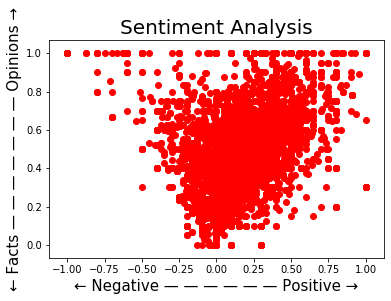

CPU times: user 3min 29s, sys: 1.16 s, total: 3min 30s
Wall time: 3min 31s


In [44]:
%%time

for index, Tweets in enumerate(df.index):
    x = df.polarity.loc[Tweets]
    y = df.subjectivity.loc[Tweets]
    plt.scatter(x, y, color='Red')
 
 
plt.title('Sentiment Analysis', fontsize = 20)
plt.xlabel('← Negative — — — — — — Positive →', fontsize=15)
plt.ylabel('← Facts — — — — — — — Opinions →', fontsize=15)
plt.show()

In [14]:
# tweets sorted by retweet count high to low
df.sort_values(by='retweets_count', ascending=False).head(10)[
    ['date', 'username', 'tweet', 'retweets_count', 'likes_count',
     'polarity', 'subjectivity']]

,date,username,tweet,retweets_count,likes_count,polarity,subjectivity
2882,2020-12-20,michael_saylor,if you want to do your shareholders a 100 bill...,1996,18710,-0.125000,0.375000
26246,2020-12-16,erickussalas,otro negocio que se va de m xico otro negocio ...,1124,2611,0.000000,0.000000
4693,2020-12-19,chrisbloomstran,let s get ready to tumble come monday tsla ent...,1022,5544,0.071591,0.401136
2380,2020-12-20,tyler,when puts the tsla balance sheet into bitcoin ...,997,8928,0.000000,0.000000
140839,2020-11-18,pulte,i bought 1 million of tesla tsla i think elon ...,864,26626,0.000000,0.000000
8040,2020-12-18,ericbalchunas,next level tsla just obliterated the all time ...,693,2820,0.153333,0.213333
130382,2020-11-20,vincent13031925,biggest mistakes of the century 80s apple aapl...,616,4369,0.000000,1.000000
121239,2020-11-23,vincent13031925,for the first time in the history tesla tsla h...,594,15747,0.025000,0.233333
104065,2020-11-27,charliebilello,tesla s market cap is now higher than berkshir...,486,1860,0.216667,0.433333
169469,2020-11-09,teslany,the first tesla taxi in nyc just hit the stree...,455,4696,0.187500,0.458333


In [15]:
# avg retweet count
avg_retweet_count = df['retweets_count'].mean()
avg_retweet_count

0.7598560820638445

In [16]:
# avg like count
avg_like_count = df['likes_count'].mean()
avg_like_count

10.902254753590588

In [17]:
# tweets sorted by polarity from most negative to least showing tweets with high signal
# in the form of retweets
pd.set_option('display.max_colwidth', -1)
df[df['likes_count'] > (avg_like_count)].sort_values(by='polarity', ascending=True).head(10)[
    ['date', 'username', 'tweet', 'retweets_count', 'likes_count',
     'polarity', 'subjectivity']]

,date,username,tweet,retweets_count,likes_count,polarity,subjectivity
9608,2020-12-18,stevenmarkryan,so that wasn t boring tsla,11,826,-1.0,1.0
33566,2020-12-14,calvinfroedge,doubled up on tsla mar 300 strike puts today i m probably insane,0,29,-1.0,1.0
82690,2020-12-03,jcoviedo6,tsla drivers are the worst,5,36,-1.0,1.0
30495,2020-12-15,28delayslater,and the award for worst actor in the premarket goes to tsla,1,88,-1.0,1.0
40583,2020-12-11,paul_essen,tsla market cap 578 billion f gm tm 306 billion uber lyft 107 billion d 61 billion i like tesla but the valuation is insane domination of car sales and ride sharing w some energy production seems already priced in where else can they go,1,11,-1.0,1.0
79326,2020-12-03,afortunetrading,panic selling when you are in a trade worst thing to do you will lose your faster than you think this is why we have trade plan system 1 entry 2 exits 3 stops based on your timeframe understand yourself your mindset twlearn spx spy aapl amzn tsla,5,33,-1.0,1.0
123153,2020-11-23,yourfavoriteai,blnk 85 then now hitting 1 300 insane tsla nio li spy,0,11,-1.0,1.0
131763,2020-11-19,verytraumatic,doesn t tsla have the worst customer service in the industry,0,12,-1.0,1.0
109403,2020-11-25,futureistesla,never after a decade tsla becomes a 3 t well diversified boring conglomerate like what ge used to be an aristocratic dividend power house the millions in equity then will fetch 10000s in monthly dividends during my retirement nominate my kids as tesla stock beneficiaries,1,13,-1.0,1.0
89863,2020-12-01,passthebeano,boring co ceo musk if a rival drug tunneling cartel offered to merge with the boring co he would have that conversation tsla tslaq,2,24,-1.0,1.0


In [18]:
# calculating the average polarity for each day
pol = df.groupby('date')['polarity'].mean()
pol = pd.DataFrame(pol, columns=['polarity'])
pol = pol.reset_index()
# pol = pol.set_index('date')
print(pol.shape)
pol.head()

(42, 2)


,date,polarity
0,2020-11-09,0.087299
1,2020-11-10,0.091046
2,2020-11-11,0.085514
3,2020-11-12,0.090712
4,2020-11-13,0.068115


In [19]:
# calculating the average subjectivity for each day
sub = df.groupby('date')['subjectivity'].mean()
sub = pd.DataFrame(sub, columns=['subjectivity'])
sub = sub.reset_index()
# sub = sub.set_index('date')
print(sub.shape)
sub.head()

(42, 2)


,date,subjectivity
0,2020-11-09,0.298711
1,2020-11-10,0.295413
2,2020-11-11,0.287297
3,2020-11-12,0.278398
4,2020-11-13,0.287605


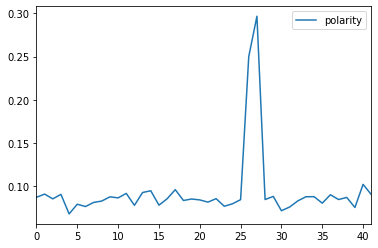

In [20]:
# plotting polarity of tweets over time
pol.plot(kind='line')
plt.show()

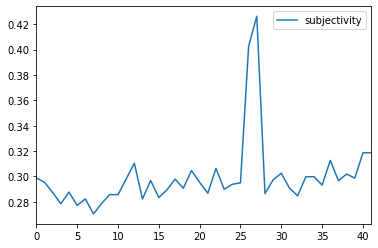

In [21]:
# plotting subjectivity of tweets over time
sub.plot(kind='line')
plt.show()

In [26]:
# enter ticker(s)
tickers = ['TSLA']

# enter start and end dates
start = dt.datetime(2020, 11, 9)
end = dt.datetime.today()

def get_stock_data(tickers):
    if not os.path.exists('stockdata'):
        os.makedirs('stockdata')
    
    for ticker in tickers:
        print(ticker)
    try : 
        df = web.DataReader(ticker, 'yahoo', start, end)
        print(df.head())
        df.to_csv('stockdata/{}.csv'. format(ticker))
        print(ticker, 'downloaded')
    except Exception as e:
        print(e, 'error')

get_stock_data(tickers)

TSLA
                  High         Low        Open       Close    Volume  \
Date                                                                   
2020-11-09  452.500000  421.000000  439.500000  421.260010  34833000   
2020-11-10  420.089996  396.029999  420.089996  410.359985  30284200   
2020-11-11  418.700012  410.579987  416.450012  417.130005  17357700   
2020-11-12  423.000000  409.519989  415.049988  411.760010  19855100   
2020-11-13  412.529999  401.660004  410.850006  408.500000  19771100   

             Adj Close  
Date                    
2020-11-09  421.260010  
2020-11-10  410.359985  
2020-11-11  417.130005  
2020-11-12  411.760010  
2020-11-13  408.500000  
TSLA downloaded


In [27]:
price = pd.read_csv('TSLA/stockdata/TSLA.csv')
print(price.shape)
price = price.rename(columns={'Date': 'date'})
price.head()

(29, 7)


,date,High,Low,Open,Close,Volume,Adj Close
0,2020-11-09,452.500000,421.000000,439.500000,421.260010,34833000,421.260010
1,2020-11-10,420.089996,396.029999,420.089996,410.359985,30284200,410.359985
2,2020-11-11,418.700012,410.579987,416.450012,417.130005,17357700,417.130005
3,2020-11-12,423.000000,409.519989,415.049988,411.760010,19855100,411.760010
4,2020-11-13,412.529999,401.660004,410.850006,408.500000,19771100,408.500000


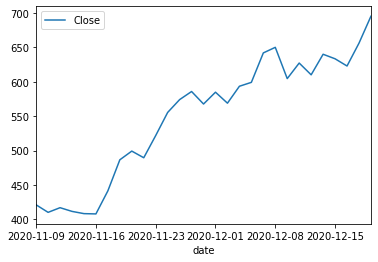

In [28]:
price.plot(x='date', y='Close')
plt.show()

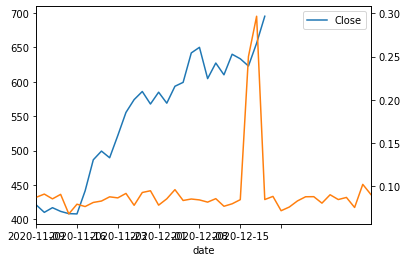

In [29]:
# graphs don't line up because of the difference in shapes
price.plot(kind='line', x='date', y='Close')
ax2 = pol['polarity'].plot(x='Date', secondary_y=True)
plt.show()

In [33]:
# combining the datasets using an outer join so that all the data persists
pol_prices = pol.merge(price, how='outer', on =['date'])
print(pol_prices.shape)
pol_prices.tail(10)

(42, 8)


,date,polarity,High,Low,Open,Close,Volume,Adj Close
32,2020-12-11,0.083134,624.000000,596.799988,615.010010,609.989990,46475000.0,609.989990
33,2020-12-12,0.087952,NaN,NaN,NaN,NaN,NaN,NaN
34,2020-12-13,0.088056,NaN,NaN,NaN,NaN,NaN,NaN
35,2020-12-14,0.080562,642.750000,610.200012,619.000000,639.830017,52040600.0,639.830017
36,2020-12-15,0.090274,646.900024,623.799988,643.280029,633.250000,45223600.0,633.250000
37,2020-12-16,0.084737,632.500000,605.000000,628.229980,622.770020,42095800.0,622.770020
38,2020-12-17,0.087171,658.820007,619.500000,628.190002,655.900024,56270100.0,655.900024
39,2020-12-18,0.075546,695.000000,628.539978,668.900024,695.000000,218741900.0,695.000000
40,2020-12-19,0.102292,NaN,NaN,NaN,NaN,NaN,NaN
41,2020-12-20,0.090521,NaN,NaN,NaN,NaN,NaN,NaN


In [34]:
# fill in NaN values with previous day close values, otherwise there are spaces
# in the line graph for price
pol_prices = pol_prices.fillna(method='ffill')
pol_prices.tail(10)

,date,polarity,High,Low,Open,Close,Volume,Adj Close
32,2020-12-11,0.083134,624.000000,596.799988,615.010010,609.989990,46475000.0,609.989990
33,2020-12-12,0.087952,624.000000,596.799988,615.010010,609.989990,46475000.0,609.989990
34,2020-12-13,0.088056,624.000000,596.799988,615.010010,609.989990,46475000.0,609.989990
35,2020-12-14,0.080562,642.750000,610.200012,619.000000,639.830017,52040600.0,639.830017
36,2020-12-15,0.090274,646.900024,623.799988,643.280029,633.250000,45223600.0,633.250000
37,2020-12-16,0.084737,632.500000,605.000000,628.229980,622.770020,42095800.0,622.770020
38,2020-12-17,0.087171,658.820007,619.500000,628.190002,655.900024,56270100.0,655.900024
39,2020-12-18,0.075546,695.000000,628.539978,668.900024,695.000000,218741900.0,695.000000
40,2020-12-19,0.102292,695.000000,628.539978,668.900024,695.000000,218741900.0,695.000000
41,2020-12-20,0.090521,695.000000,628.539978,668.900024,695.000000,218741900.0,695.000000


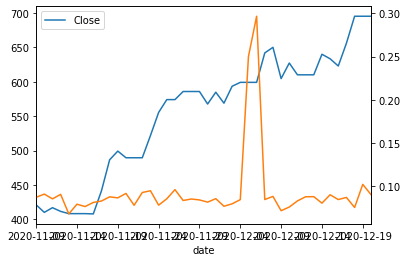

In [35]:
pol_prices.plot(kind='line', x='date', y='Close')
ax2 = pol_prices['polarity'].plot(x='date', secondary_y=True)
plt.show()

In [323]:
df.to_csv('bur_tweets.csv')

In [325]:
pol_prices.to_csv('bur_price_vs_sentiment.csv')

In [382]:
tweet_volume_by_date = tweet_volume_by_date.reset_index()
print(tweet_volume_by_date.shape)
tweet_volume_by_date

(1609, 38)


,level_0,index,date,id,conversation_id,created_at,time,timezone,user_id,username,...,geo,source,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest
0,0,0,2009-09-27,1,1,1,1,1,1,1,...,0,0,0,0,0,1,0,0,0,0
1,1,1,2009-10-20,2,2,2,2,2,2,2,...,0,0,0,0,0,2,0,0,0,0
2,2,2,2009-10-25,1,1,1,1,1,1,1,...,0,0,0,0,0,1,0,0,0,0
3,3,3,2009-11-02,1,1,1,1,1,1,1,...,0,0,0,0,0,1,0,0,0,0
4,4,4,2009-11-04,1,1,1,1,1,1,1,...,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1604,1604,1604,2020-12-01,2,2,2,2,2,2,2,...,0,0,0,0,0,2,0,0,0,0
1605,1605,1605,2020-12-02,5,5,5,5,5,5,5,...,0,0,0,0,0,5,0,0,0,0
1606,1606,1606,2020-12-06,1,1,1,1,1,1,1,...,0,0,0,0,0,1,0,0,0,0
1607,1607,1607,2020-12-14,1,1,1,1,1,1,1,...,0,0,0,0,0,1,0,0,0,0


In [403]:
print(price.shape)
price.head(11)

(2814, 7)


,date,High,Low,Open,Close,Volume,Adj Close
0,2009-10-21,109.000000,104.5,104.5,107.5,117172.0,87.489159
1,2009-10-22,109.500000,107.0,107.5,108.0,17156.0,87.896072
2,2009-10-23,108.000000,108.0,108.0,108.0,0.0,87.896072
3,2009-10-26,109.500000,108.0,108.0,107.5,81673.0,87.489159
4,2009-10-27,109.444000,106.0,108.5,107.5,29492.0,87.489159
5,2009-10-28,107.000000,107.0,107.0,107.0,0.0,87.082222
6,2009-10-29,107.750000,105.0,107.0,107.5,13456.0,87.489159
7,2009-10-30,108.300003,105.0,107.5,107.5,16258.0,87.489159
8,2009-11-02,109.000000,107.5,107.5,107.5,13000.0,87.489159
9,2009-11-03,107.500000,107.5,107.5,107.5,0.0,87.489159


In [413]:
price_v_tweets = pd.merge(price, tweet_volume_by_date, how='outer', on='date', indicator=True)
# price_v_tweets = price_v_tweets.fillna(method='ffill')
print(price_v_tweets.shape)
price_v_tweets.head(50)

(3145, 45)


,date,High,Low,Open,Close,Volume,Adj Close,level_0,index,id,...,source,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest,_merge
0,2009-10-21,109.000000,104.500000,104.5,107.5,117172.0,87.489159,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
1,2009-10-22,109.500000,107.000000,107.5,108.0,17156.0,87.896072,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
2,2009-10-23,108.000000,108.000000,108.0,108.0,0.0,87.896072,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
3,2009-10-26,109.500000,108.000000,108.0,107.5,81673.0,87.489159,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
4,2009-10-27,109.444000,106.000000,108.5,107.5,29492.0,87.489159,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
5,2009-10-28,107.000000,107.000000,107.0,107.0,0.0,87.082222,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
6,2009-10-29,107.750000,105.000000,107.0,107.5,13456.0,87.489159,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
7,2009-10-30,108.300003,105.000000,107.5,107.5,16258.0,87.489159,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
8,2009-11-02,109.000000,107.500000,107.5,107.5,13000.0,87.489159,3.0,3.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,both
9,2009-11-03,107.500000,107.500000,107.5,107.5,0.0,87.489159,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only


In [414]:
price_v_tweets = price_v_tweets.sort_values(by='date', ascending=True)
price_v_tweets = price_v_tweets.set_index('date')
price_v_tweets.head(10)

,High,Low,Open,Close,Volume,Adj Close,level_0,index,id,conversation_id,...,source,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest,_merge
date,,,,,,,,,,,,,,,,,,,,,
2009-09-27,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,right_only
2009-10-20,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,2.0,2.0,...,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,right_only
2009-10-21,109.000,104.5,104.5,107.5,117172.0,87.489159,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
2009-10-22,109.500,107.0,107.5,108.0,17156.0,87.896072,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
2009-10-23,108.000,108.0,108.0,108.0,0.0,87.896072,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
2009-10-25,NaN,NaN,NaN,NaN,NaN,NaN,2.0,2.0,1.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,right_only
2009-10-26,109.500,108.0,108.0,107.5,81673.0,87.489159,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
2009-10-27,109.444,106.0,108.5,107.5,29492.0,87.489159,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
2009-10-28,107.000,107.0,107.0,107.0,0.0,87.082222,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only


In [415]:
price_v_tweets['Close'] = price_v_tweets['Close'].fillna(method='ffill')
price_v_tweets.head(10)

,High,Low,Open,Close,Volume,Adj Close,level_0,index,id,conversation_id,...,source,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest,_merge
date,,,,,,,,,,,,,,,,,,,,,
2009-09-27,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,right_only
2009-10-20,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,2.0,2.0,...,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,right_only
2009-10-21,109.000,104.5,104.5,107.5,117172.0,87.489159,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
2009-10-22,109.500,107.0,107.5,108.0,17156.0,87.896072,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
2009-10-23,108.000,108.0,108.0,108.0,0.0,87.896072,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
2009-10-25,NaN,NaN,NaN,108.0,NaN,NaN,2.0,2.0,1.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,right_only
2009-10-26,109.500,108.0,108.0,107.5,81673.0,87.489159,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
2009-10-27,109.444,106.0,108.5,107.5,29492.0,87.489159,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
2009-10-28,107.000,107.0,107.0,107.0,0.0,87.082222,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only


In [423]:
price_v_tweets['tweet'] = price_v_tweets['tweet'].fillna(0)

In [424]:
price_v_tweets[['Close', 'tweet']]

,Close,tweet
date,,
2009-09-27,NaN,1.0
2009-10-20,NaN,2.0
2009-10-21,107.5,0.0
2009-10-22,108.0,0.0
2009-10-23,108.0,0.0
...,...,...
2020-12-11,695.5,0.0
2020-12-14,704.5,1.0
2020-12-15,722.5,0.0


In [426]:
price_v_tweets.to_csv('price_v_tweets.csv')

In [430]:
pd.set_option('display.max_colwidth', -1)
df[df['date'] == '2019-07-25'].sort_values(by='polarity', ascending=True).head(50)[
    ['date', 'username', 'tweet', 'retweets_count', 'likes_count',
     'polarity', 'subjectivity']]

,date,username,tweet,retweets_count,likes_count,polarity,subjectivity
1350,2019-07-25,vanillahedging,what s your rationale for being skeptical about bur would you short it,0,0,-0.250000,0.400000
1359,2019-07-25,bluff_capital,brfrf bur burford results 2 2,0,1,0.000000,0.000000
1375,2019-07-25,typicalvalue,bur h1 2019 highlights parece otra sacada de buford roic al 98 y irr a 32,5,14,0.000000,0.000000
1374,2019-07-25,typicalvalue,bur estructura del portfolio actual,0,2,0.000000,0.100000
1373,2019-07-25,typicalvalue,bur,0,4,0.000000,0.000000
1372,2019-07-25,salbor,viendo report h1 de bur por el momento los irr y roic siguen sin deteriorarse empieza a florecer el vintage de 2017 y va bien o mejor es la mejor noticia,0,2,0.000000,0.000000
1370,2019-07-25,boina_inversora,conference call a las 3pm hora espa ola bur,0,2,0.000000,0.000000
1369,2019-07-25,teruelborja,vaya resultados de burford bur los ingresos han aumentado un 40 los beneficios despu s de impuestos han crecido un 36 burford ha aumentado sus activos en un 37 la demanda de capital que ha recibido burford ha aumentado un 36,0,10,0.000000,0.000000
1367,2019-07-25,boina_inversora,bur,0,2,0.000000,0.000000
1366,2019-07-25,casasperep,bur,0,2,0.000000,0.000000
